<h1 style="text-align:center">Airborne Object Tracking Dataset</h1>

# ⏱ Loading the Dataset

In [2]:
import json
import random
import os, sys
from IPython.display import display, clear_output, HTML
from random import randrange, choice
import matplotlib.pyplot as plt
plt.rcParams["figure.figsize"]=25,25
import numpy as np
import seaborn as sns
from loguru import logger

random.seed(42)

In [3]:
sys.path.append(os.path.dirname(os.path.realpath(os.getcwd())))
sys.path.append(os.path.dirname(os.path.realpath(os.getcwd())) + "/core")

!pip install -r ../requirements.txt > /dev/null

from core.dataset import Dataset
notebook_path = os.path.dirname(os.path.realpath("__file__")) + "/tempData"
local_path = notebook_path + '/part1'
s3_path = 's3://airborne-obj-detection-challenge-training/part1/'
dataset = Dataset(local_path, s3_path, partial=True, prefix="part1")
local_path = notebook_path + '/part2'
s3_path = 's3://airborne-obj-detection-challenge-training/part2/'
dataset.add(local_path, s3_path, prefix="part2")
local_path = notebook_path + '/part3'
s3_path = 's3://airborne-obj-detection-challenge-training/part3/'
dataset.add(local_path, s3_path, prefix="part3")

clear_output()

flight_ids = dataset.get_flight_ids()
logger.info("All Flight IDS: {}", flight_ids)

flight = dataset.get_flight(flight_ids[0])  # Loading single flight
logger.info("Chosen Flight: {}", flight)

frmes = flight.frames  # All the frames of the flight
airborne_objects = flight.get_airborne_objects()  # Get all airborne objects
for airborneObject in airborne_objects:
    logger.info("Airborne Object: {} ", airborneObject)

# flight_ids = dataset.get_flight_ids()
# for flight in flight_ids:
#     currentFlight = dataset.get_flight(flight)
#     logger.info("Downloading Flight: {}", currentFlight)
#     currentFlight.download()
#     logger.info("Download Completed")
# logger.info("All Flights Downloaded")

2022-02-01 12:12:32.618 | INFO     | __main__:<module>:21 - All Flight IDS: ['part100bb96a5a68f4fa5bc5c5dc66ce314d2', 'part182c003b45857406b8eded5115cc0118d', 'part1829d263844ed4387b374fe9db9a510e4', 'part143a99be53c3a4176a8f7d9e10f8bd29c', 'part14d196dd04a23411193d525b2356a1187', 'part101a7a84b9226468bbb7f88d483c3e996', 'part16e8de53f981f481c8090c7bcb9f66b44', 'part10f7714af364842449ee42f31b0446e2f', 'part140a522741b434597869ea7d751ad6c7d', 'part12a3f9954e29a494c822d1a28adf5cd51', 'part169904ae4f18d46ec8886e8fd6179171b', 'part11b276556ba4444baaae96589623ba18c', 'part104e4d5704d1e4a18933a544c86826064', 'part1631e499cdbd64dbeafec76d54e0f2716', 'part114c25ef422b64c3b8114d92cf5de4cfb', 'part13fd5b63cb26844bba1eb9a712db38973', 'part16d2916d00dd940f4b67d31856b2af7a1', 'part13d739c8d23d240f68fd84aeda4577fa5', 'part11748d11a89fd4ded8885a3778b1241b5', 'part15f95596edc86439dbd19a252ff5760b7', 'part16fe6d5fe0309403783bb9d18782c9288', 'part103beb5fc6c154d308e14cf672d20e176', 'part165e39dcc372d422

2022-02-01 12:12:32.618 | INFO     | __main__:<module>:24 - Chosen Flight: Flight#part100bb96a5a68f4fa5bc5c5dc66ce314d2(num_frames=93, num_airborne_objs=1)
2022-02-01 12:12:32.618 | INFO     | __main__:<module>:29 - Airborne Object: AirborneObject#Airplane1(num_frames=93, planned=True) 


## 🌱 Ground Truth Structure

Ground truth (present in `ImageSets` folder) contains all the relevant information regarding airborne objects, their locations, bbox and so on.
While the `Images` folder have accompanied images for your training code to work on.

Before we start, let's check the vocabulary we will need to understand the dataset:

* `flights` (a.k.a. `samples` in ground truth):<br>
  One flight is typically 2 minutes video at 10 fps i.e. 1200 images. Each of the frames are present in `Images/{{flight_id}}/` folder. These files are typically 3-4mb each.


* `frame` (a.k.a. `entity` in ground truth):<br>
  This is the most granular unit on which dataset can be sampled. Each frame have information timestamp, frame_id, and label `is_above_horizon`.
  There can be multiple entries for same frame in `entity` when multiple Airborne objects are present.<br>
  When an Airborne object following information is available as well:
  - `id` -> signifies unique ID of this object (for whole frame)
  - `bbox` -> it contains 4 floats signifying `[left, top, width, height]`
  - `blob['range_distance_m']` -> distance of airborne object
  - `labels['is_above_horizon']` -> details below
  - (derived) `planned` -> for the planned objects `range_distance_m` is available
    

* `is_above_horizon`:<br>
  It is marked as 1 when Airborne object is above horizon and -1 when it is below horizon. When unclear, it is marked as 0.

Example for frame level data (multiple per frame):

```json
{
    'time': 1550844897919368155,
    'blob': {
        'frame': 480,
        'range_distance_m': nan # signifies, it was an unplanned object
    },
    'id': 'Bird2',
    'bb': [1013.4, 515.8, 6.0, 6.0],
    'labels': {'is_above_horizon': 1},
    'flight_id': '280dc81adbb3420cab502fb88d6abf84',
    'img_name': '1550844897919368155280dc81adbb3420cab502fb88d6abf84.png'
}
```

# 👀 DeepDive into Flight

In [5]:
all_flight_ids = dataset.get_flight_ids()
lucky_flight_id = random.choice(all_flight_ids)
lucky_flight = dataset.get_flight_by_id(lucky_flight_id)

print("🔮Lucky draw tells us to continue with: `%s` \n" % lucky_flight_id)

print(lucky_flight)

print("This flight has %s frames and total %s airborne objects." % (lucky_flight.num_frames, lucky_flight.num_airborne_objs))

print("List of Airborne Objects: ")
for airborne_obj in lucky_flight.get_airborne_objects():
    print("- %s " % airborne_obj)

assert lucky_flight.num_airborne_objs > 0, "Unlucky draw; this flight sequence have 0 airborne objects; please re-run this cell"

🔮Lucky draw tells us to continue with: `part142bf09e877524fc1a405faa47aa7231c` 

Flight#part142bf09e877524fc1a405faa47aa7231c(num_frames=60, num_airborne_objs=1)
This flight has 60 frames and total 1 airborne objects.
List of Airborne Objects: 
- AirborneObject#Helicopter1(num_frames=60, planned=True) 


### Download Flight

In [6]:
lucky_flight.download()

### Get Single Flight Image

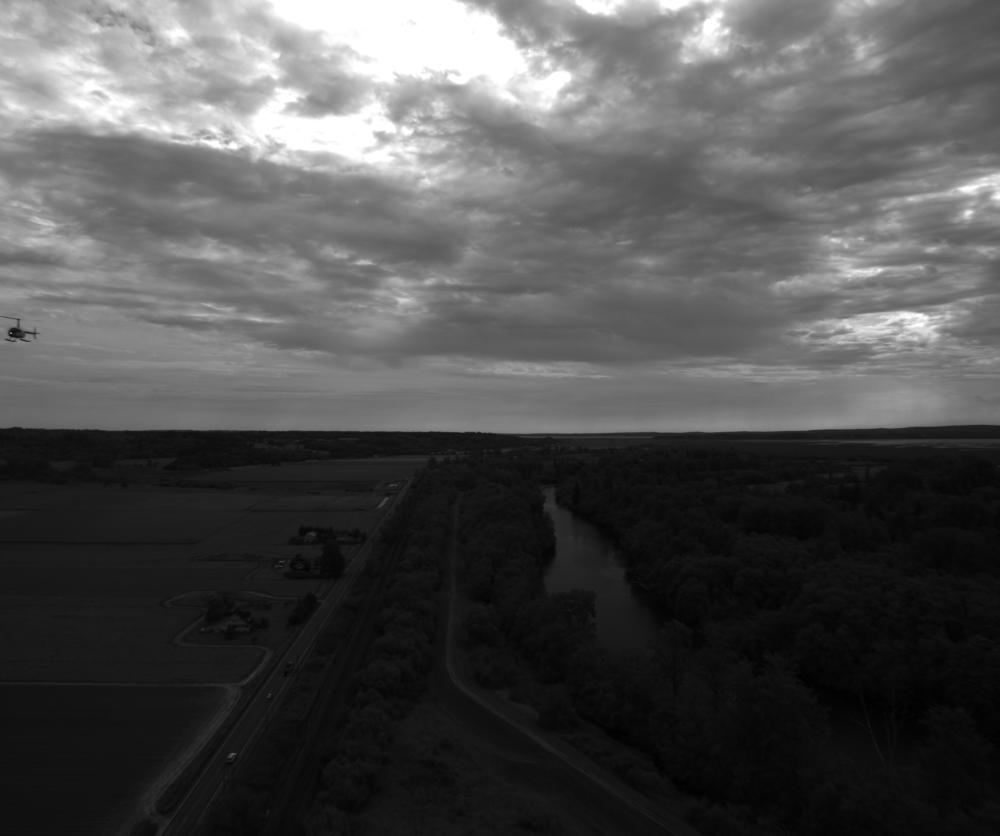

In [7]:
image = lucky_flight.get_frame(choice(list(lucky_flight.frames.keys()))).image()
display(image)

### Get Multiple Images

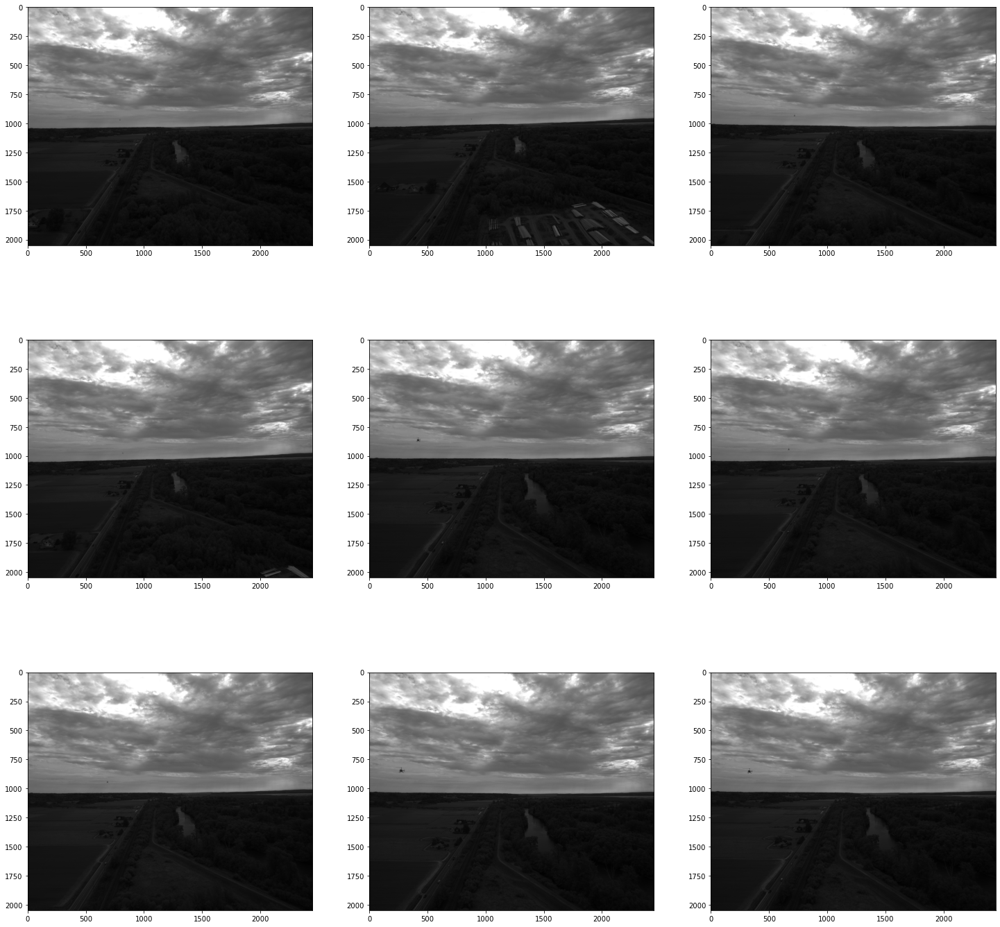

In [8]:
%matplotlib inline
import matplotlib.pyplot as plt
plt.rcParams["figure.figsize"]=25,25
fig = plt.figure()

for i in range(1, 10):
    ax = fig.add_subplot(3, 3, i)
    ax.imshow(lucky_flight.get_frame(choice(list(lucky_flight.frames.keys()))).image(type='cv2'))

plt.show()

#### 📉 Presence of the objects and their distance vs frames

<Figure size 2000x2000 with 0 Axes>

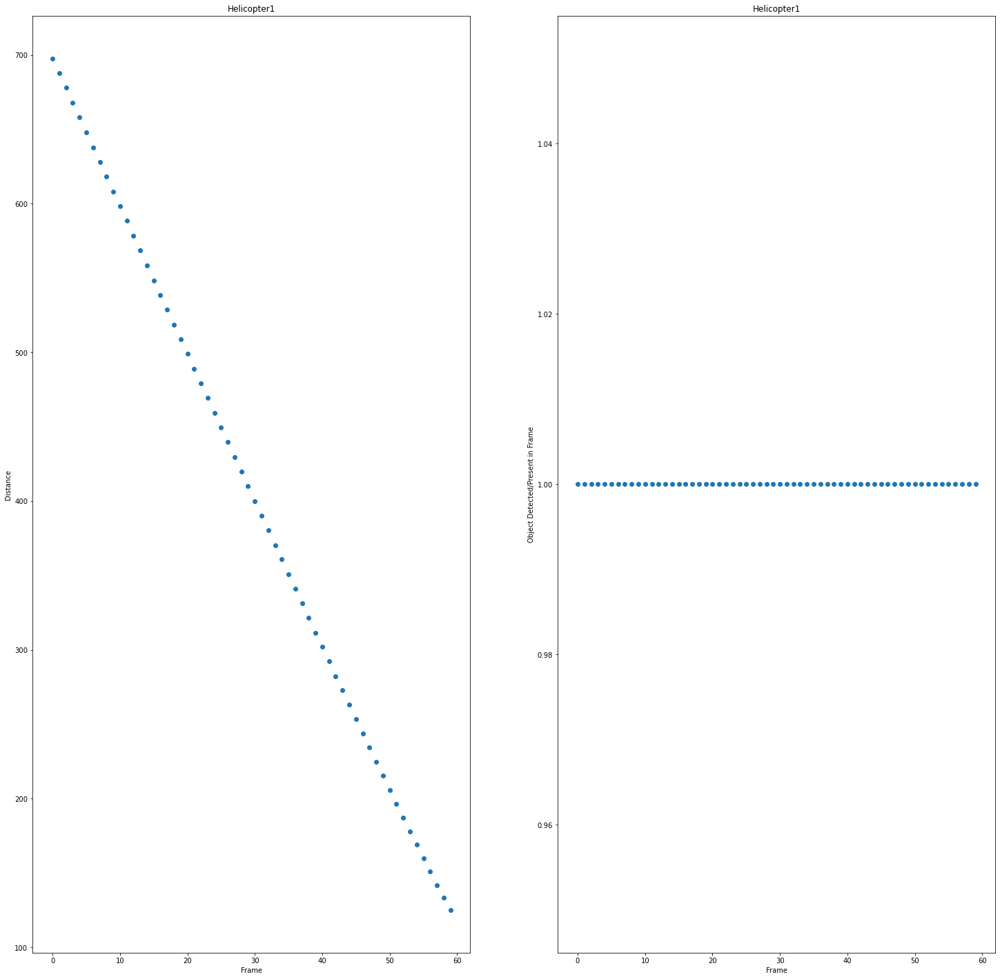

None

In [9]:
airborne_objects = lucky_flight.detected_objects
frames = lucky_flight.frames

rows = len(airborne_objects.keys())

detected = {}
distance = {}

#Get object's distance and its presence/detected for each frame.
for frame_id in lucky_flight.frames:
    f = lucky_flight.get_frame(frame_id)
    for obj in airborne_objects:
        if obj not in detected:
            detected[obj] = []
            distance[obj] = []

        if obj in f.detected_objects:
            detected[obj].append(True)
            distance[obj].append(f.detected_object_locations[obj].range_distance_m)
        else:
            detected[obj].append(False)
            if not airborne_objects[obj].planned:
                distance[obj].append(float("NaN"))
            else:
                distance[obj].append(0)

i = 0
f = plt.figure(figsize=(25, 25), dpi=80)
f, axes = plt.subplots(nrows = rows, ncols = 2, squeeze=False)

for obj in detected:
    axes[i][0].scatter(range(len(distance[obj])), distance[obj])
    axes[i][0].set_xlabel('Frame')
    axes[i][0].set_ylabel('Distance')
    axes[i][0].set_title(obj)
    
    # Display empty graph if no objects detected
    if not airborne_objects[obj].planned:
        plt.text(0.3, 0.2, "Unplanned objects\ndon't have distance", 
                 fontsize=22, transform=axes[i][0].transAxes, color="red")

    axes[i][1].scatter(range(len(detected[obj])), detected[obj])
    axes[i][1].set_xlabel('Frame')
    axes[i][1].set_ylabel('Object Detected/Present in Frame')
    axes[i][1].set_title(obj)
    i += 1
    
display(plt.show())

# print(detected)
# print(distance)

## 📉 Visualise Planned Object Image & Video

Types Of Airborne Objects In Dataset :  ['Airplane', 'Helicopter', 'Drone', 'Airborne', 'Flock', 'Bird']


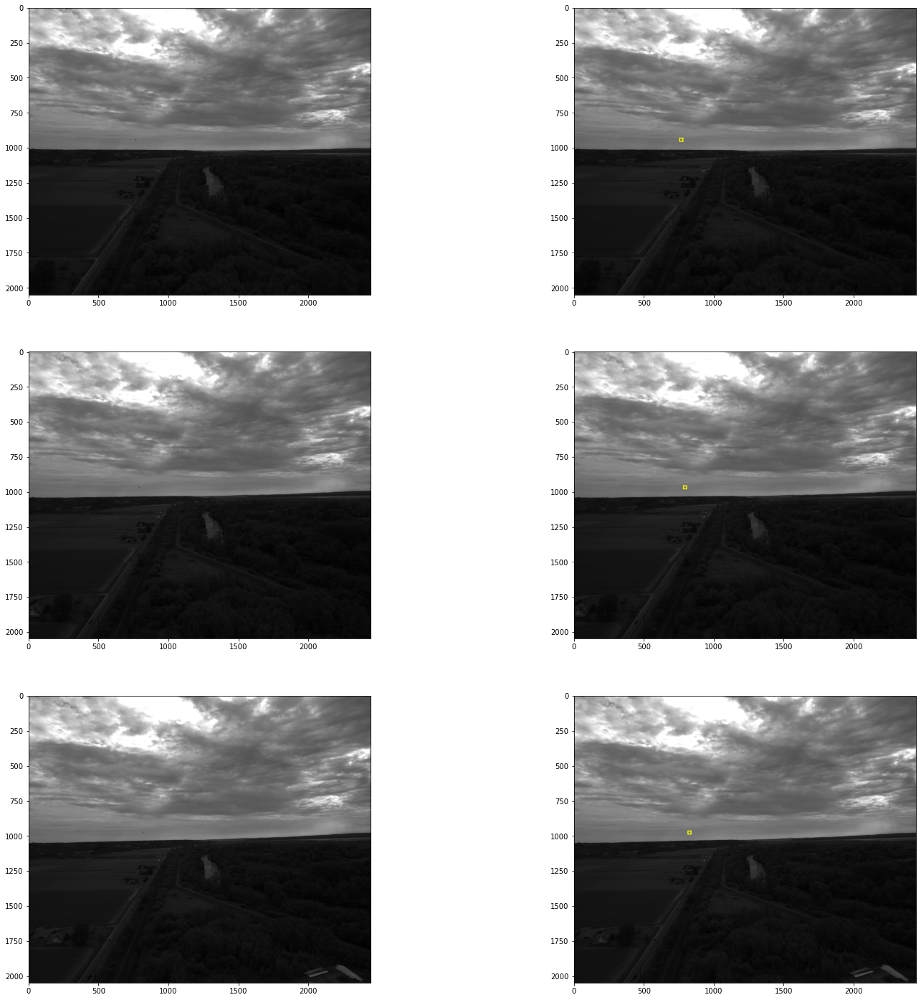

In [45]:
%matplotlib inline
import matplotlib.pyplot as plt
plt.rcParams["figure.figsize"]=25,25
import re

import time

# Get one of the "planned" object
airborne_objects = lucky_flight.detected_objects
obj_of_interest = None

for obj in airborne_objects:
    # Check If Object is planned
    if airborne_objects[obj].planned:
        obj_of_interest = airborne_objects[obj]
        break

typesOfObject = []
flight_idsTest = dataset.get_flight_ids()
for flight in flight_idsTest:
    airborne_objects_test = dataset.get_flight(flight).detected_objects
    for detected_obj in airborne_objects_test:
        if re.match(r"([a-z]+)([0-9]+)", airborne_objects_test[detected_obj].id, re.I).groups()[0] not in typesOfObject:
            match = re.match(r"([a-z]+)([0-9]+)", airborne_objects_test[detected_obj].id, re.I)
            if match : typesOfObject.append(match.groups()[0])

print("Types Of Airborne Objects In Dataset : ", typesOfObject)
images = []
fig = plt.figure()

#Create Comparision before vs after
for i in range(1, 7, 2):
    frame = obj_of_interest.location[randrange(obj_of_interest.num_frames)].frame # Get random Frame
    ax = fig.add_subplot(3, 2, i)
    ax.imshow(frame.image(type='cv2'))
    ax = fig.add_subplot(3, 2, i + 1)
    ax.imshow(frame.image_annotated())

plt.show()

In [19]:
# Generate Video
flight_path = lucky_flight.generate_video()

from base64 import b64encode
mp4 = open(flight_path, 'rb').read()
data_url = "data:video/mp4;base64," + b64encode(mp4).decode()
HTML("""
<video width=400 controls>
      <source src="%s" type="video/mp4">
</video>
""" % data_url)

### Overall Distribution Of Dataset

#### ✈️ Airborne Objects Count Distribution

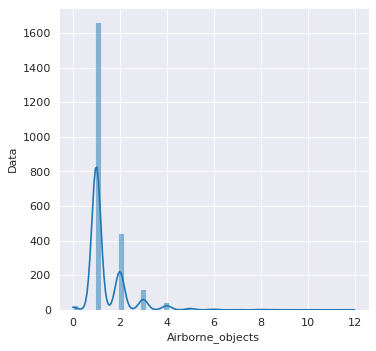

None

Avg:  1.4082332761578045
Min:  0
Max:  12


In [25]:
num_objects = []
for flight_id in dataset.get_flight_ids():
    num_objects.append(dataset.get_flight(flight_id).num_airborne_objs)

# Histogram of data vs number of airborne objects
plt.figure(figsize=(5, 5), dpi=80)
with sns.axes_style("darkgrid"):
  sns.histplot(num_objects, kde=True, bins=50)
plt.ylabel('Data')
plt.xlabel('Airborne_objects')
display(plt.show())


print("Avg: ", sum(num_objects) / len(num_objects))
print("Min: ", min(num_objects))
print("Max: ", max(num_objects))

### Distance Against Frame Distribution

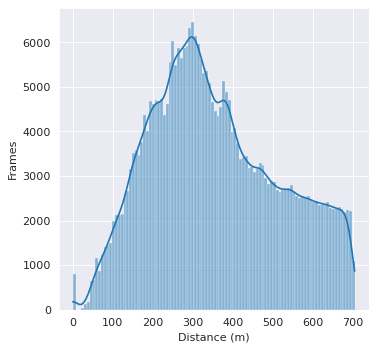

None

Avg:  357.47606311292395
Min:  0.003613452338291784
Max:  703.5743826104314


In [26]:
obj_distance = []

# Get Distance of each flight
for flight_id in dataset.get_flight_ids():
    flight = dataset.get_flight(flight_id)
    for obj in flight.detected_objects:
        if flight.detected_objects[obj].planned:
            for loc in flight.detected_objects[obj].location:
                obj_distance.append(loc.range_distance_m)

plt.figure(figsize=(5, 5), dpi=80)
with sns.axes_style("darkgrid"):
  sns.histplot(obj_distance, kde=True, bins=100)
plt.ylabel('Frames')
plt.xlabel('Distance (m)')
display(plt.show())

print("Avg: ", sum(obj_distance) / len(obj_distance))
print("Min: ", min(obj_distance))
print("Max: ", max(obj_distance))

## Heatmap Of Average Bounding Box Distribution

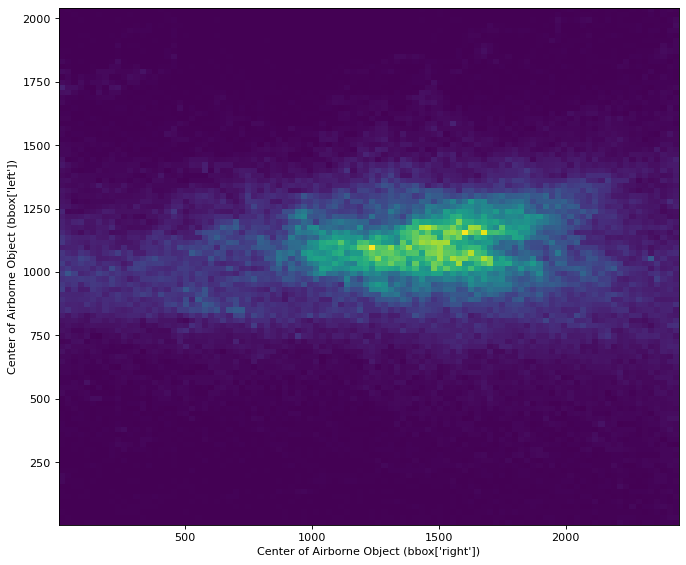

In [30]:
#From Online
obj_center_left = []
obj_center_top = []

for flight_id in dataset.get_flight_ids():
    flight = dataset.get_flight(flight_id)
    for obj in flight.detected_objects:
        if flight.detected_objects[obj].planned:
            for loc in flight.detected_objects[obj].location:
                left, top = loc.bb.get_center()
                obj_center_left.append(left)
                obj_center_top.append(top)

heatmap, xedges, yedges = np.histogram2d(obj_center_left, obj_center_top, bins=100)
extent = [xedges[0], xedges[-1], yedges[0], yedges[-1]]

plt.figure(figsize=(10, 10), dpi=80)
plt.clf()
plt.imshow(heatmap.T, extent=extent, origin='lower')
plt.ylabel("Center of Airborne Object (bbox['left'])")
plt.xlabel("Center of Airborne Object (bbox['right'])")
plt.show()